In [1]:
import torch
import os
print("PyTorch version:", torch.__version__)
print("CUDA available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("CUDA version:", torch.version.cuda)
    print("cuDNN version:", torch.backends.cudnn.version())

# Create checkpoints directory if it does not exist
if not os.path.exists('checkpoints'):
    os.makedirs('checkpoints')

PyTorch version: 2.3.0+cu121
CUDA available: True
CUDA version: 12.1
cuDNN version: 8801


In [2]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from model import SRCNN
import torch.nn as nn
import torch.optim as optim
from os import listdir
from os.path import join
from data import DatasetFromFolder, load_img
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

d:\Program Files\Miniconda\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# Define the evaluate function
def evaluate(model, val_loader, criterion, device):
    model.eval()
    val_loss = 0.0
    psnr = 0.0
    if len(val_loader.dataset) == 0:
        print("Validation dataset is empty. Please check the dataset path and contents.")
        return None, None
    
    with torch.no_grad():
        for inputs, targets, _, _ in val_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            val_loss += loss.item() * inputs.size(0)
            psnr += 10 * torch.log10(1 / loss)

    val_loss /= len(val_loader.dataset)
    psnr /= len(val_loader.dataset)
    return val_loss, psnr

In [4]:
def is_image_file(filename):
    return any(filename.endswith(extension) for extension in [".png", ".jpg", ".jpeg", ".bmp"])

In [5]:
# Define the visualize_images function
def visualize_images(inputs, outputs, cb, cr, epoch, output_dir='output_images'):
    inputs = inputs.cpu().numpy().transpose(0, 2, 3, 1)
    outputs = outputs.cpu().detach().numpy().transpose(0, 2, 3, 1)
    cb = cb.cpu().numpy().transpose(0, 2, 3, 1)
    cr = cr.cpu().numpy().transpose(0, 2, 3, 1)
    n = min(inputs.shape[0], 5)
    fig, axes = plt.subplots(2, n, figsize=(15, 5))
    for i in range(n):
        input_y = Image.fromarray((inputs[i].squeeze() * 255).astype(np.uint8))
        output_y = Image.fromarray((outputs[i].squeeze() * 255).astype(np.uint8))

        input_cb = Image.fromarray((cb[i].squeeze() * 255).astype(np.uint8))
        input_cr = Image.fromarray((cr[i].squeeze() * 255).astype(np.uint8))

        input_img = Image.merge('YCbCr', [input_y, input_cb, input_cr]).convert('RGB')
        output_img = Image.merge('YCbCr', [output_y, input_cb, input_cr]).convert('RGB')

        axes[0, i].imshow(input_img)
        axes[0, i].set_title(f'Input {i+1}')
        axes[0, i].axis('off')

        axes[1, i].imshow(output_img)
        axes[1, i].set_title(f'Output {i+1}')
        axes[1, i].axis('off')

    plt.suptitle(f'Epoch {epoch}')
    plt.savefig(f'{output_dir}/epoch_{epoch}.png')
    plt.show()
    plt.close()

In [6]:
# Training settings
batch_size = 8  # Reduced batch size
num_epochs = 50
learning_rate = 0.001
zoom_factor = 2
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda:0


In [7]:
# Data preprocessing
image_size = (128, 128)
input_transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor()
])
target_transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor()
])

In [8]:
# Load datasets
train_dataset_path = 'dataset/train'
val_dataset_path = 'dataset/val'
train_dataset = DatasetFromFolder(train_dataset_path, zoom_factor=zoom_factor, input_transform=input_transform, target_transform=target_transform)
val_dataset = DatasetFromFolder(val_dataset_path, zoom_factor=zoom_factor, input_transform=input_transform, target_transform=target_transform)

train_loader = DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(dataset=val_dataset, batch_size=batch_size, shuffle=False)

In [9]:
# Model, loss function, optimizer
model = SRCNN(num_channels=1).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

d:\Program Files\Miniconda\Lib\site-packages\torch\nn\modules\conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ..\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
d:\Program Files\Miniconda\Lib\site-packages\torch\autograd\graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ..\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Epoch 1/50, Loss: 0.1194
Validation Loss: 0.0231, PSNR: 2.53


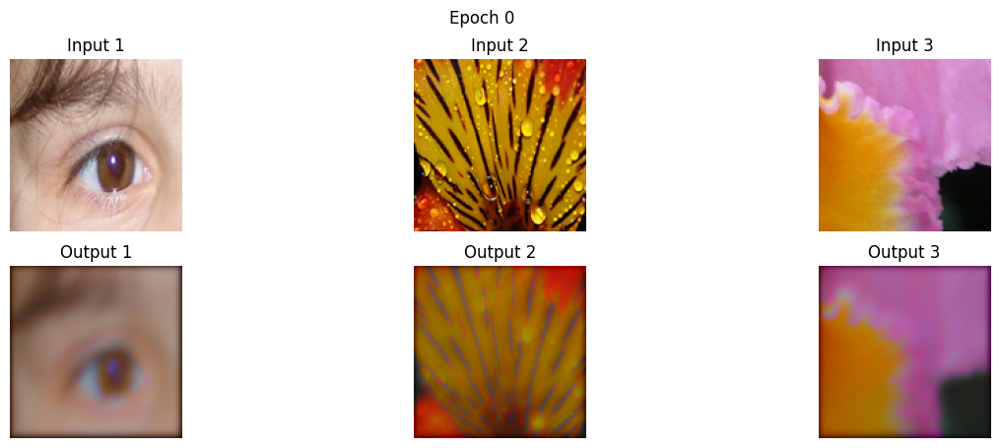

Epoch 2/50, Loss: 0.0344
Validation Loss: 0.0264, PSNR: 2.44


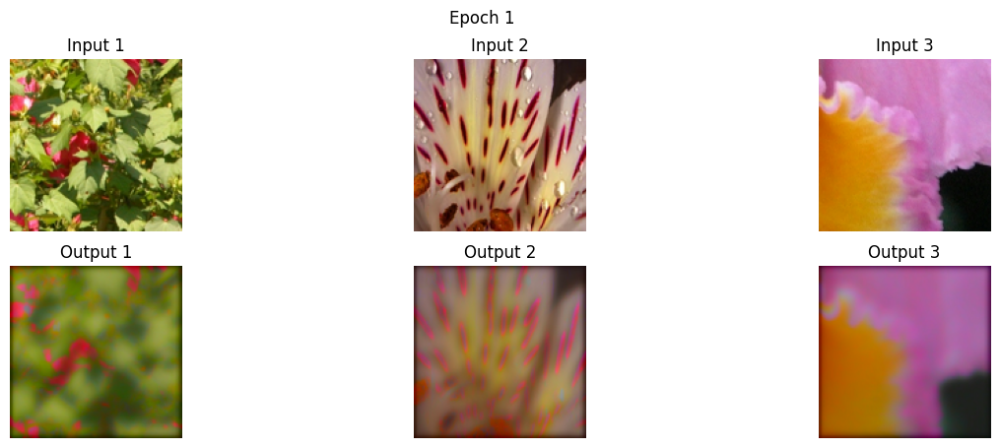

Epoch 3/50, Loss: 0.0191
Validation Loss: 0.0164, PSNR: 2.77


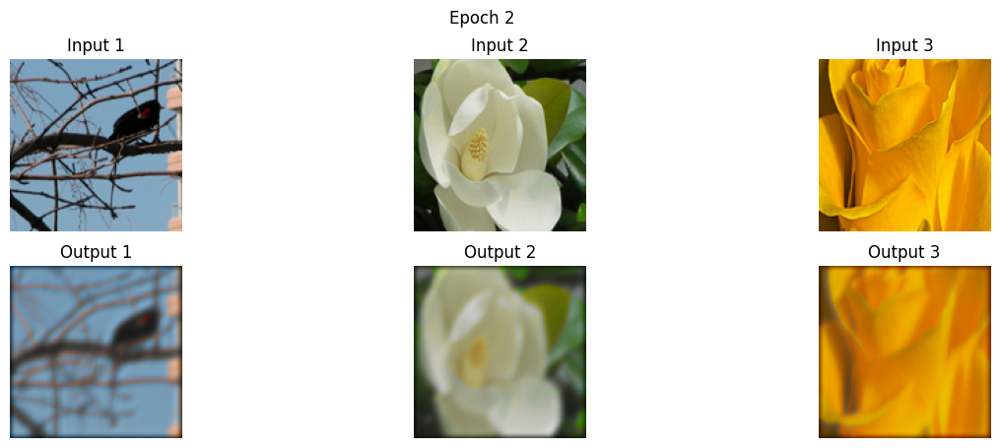

Epoch 4/50, Loss: 0.0128
Validation Loss: 0.0107, PSNR: 3.06


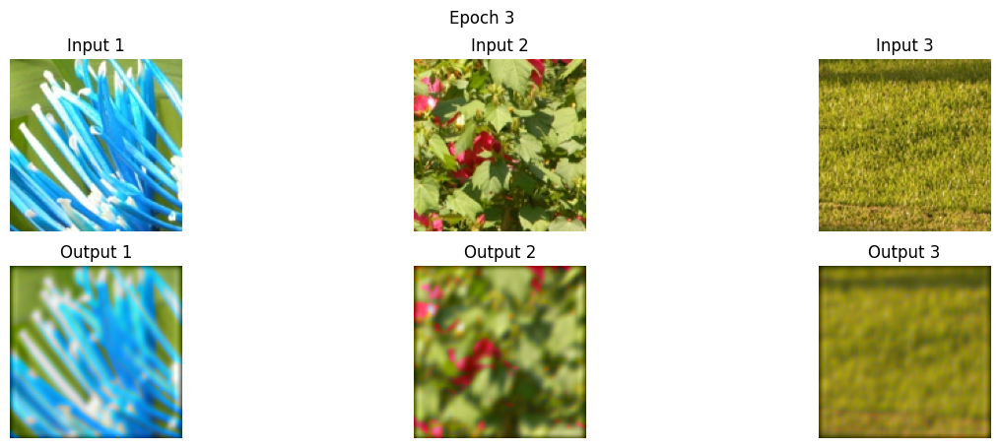

Epoch 5/50, Loss: 0.0087
Validation Loss: 0.0089, PSNR: 3.18


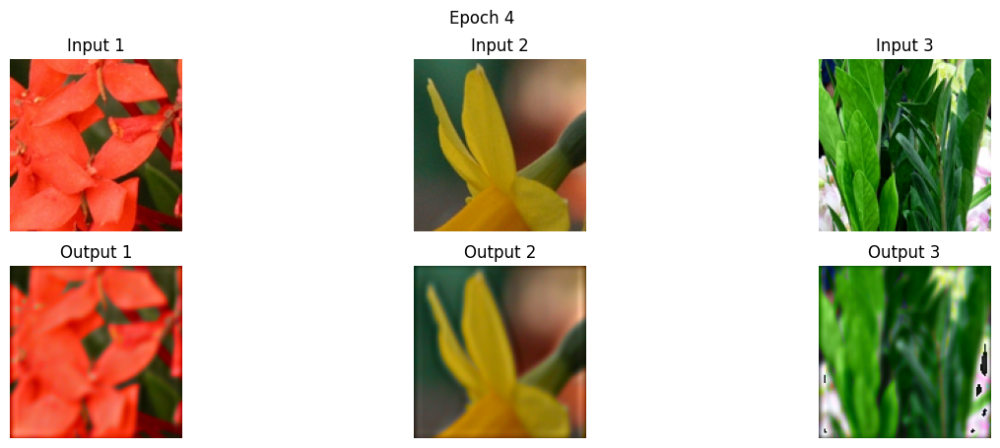

Epoch 6/50, Loss: 0.0065
Validation Loss: 0.0071, PSNR: 3.34


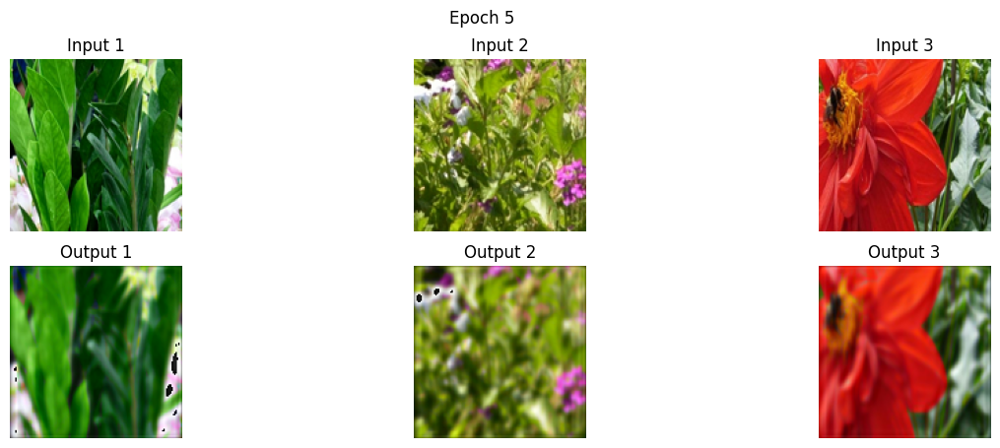

Epoch 7/50, Loss: 0.0048
Validation Loss: 0.0052, PSNR: 3.54


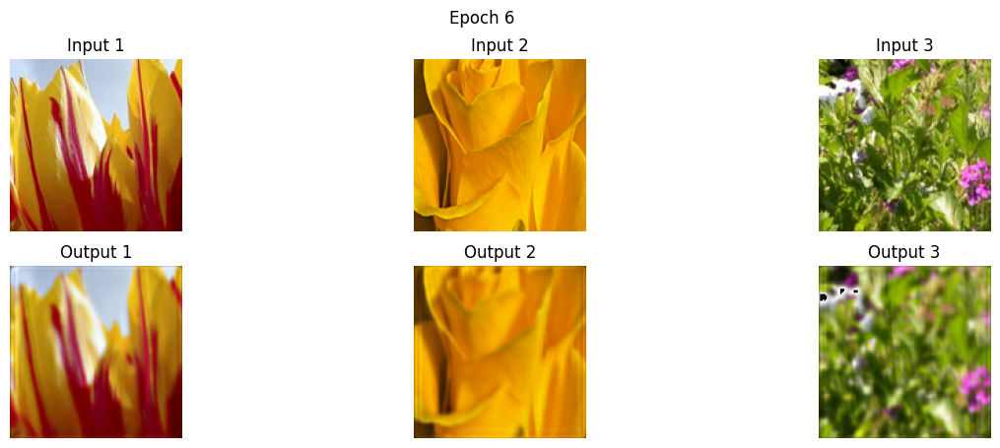

Epoch 8/50, Loss: 0.0032
Validation Loss: 0.0039, PSNR: 3.75


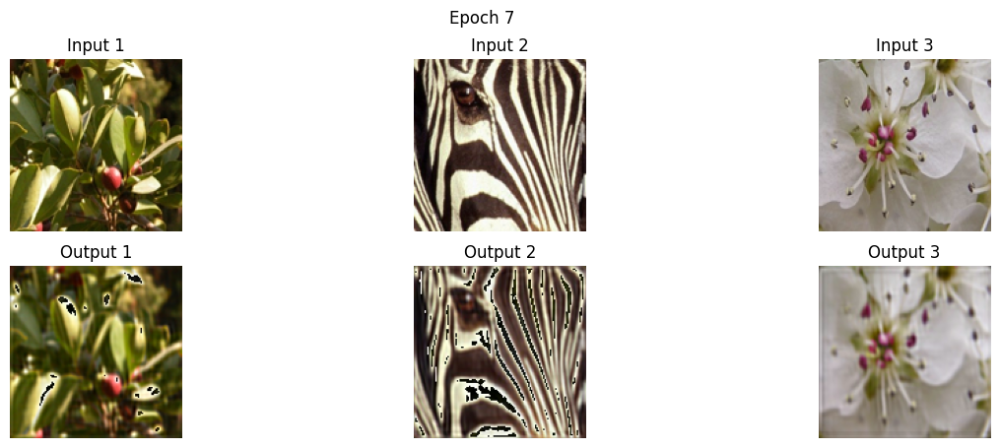

Epoch 9/50, Loss: 0.0022
Validation Loss: 0.0029, PSNR: 3.96


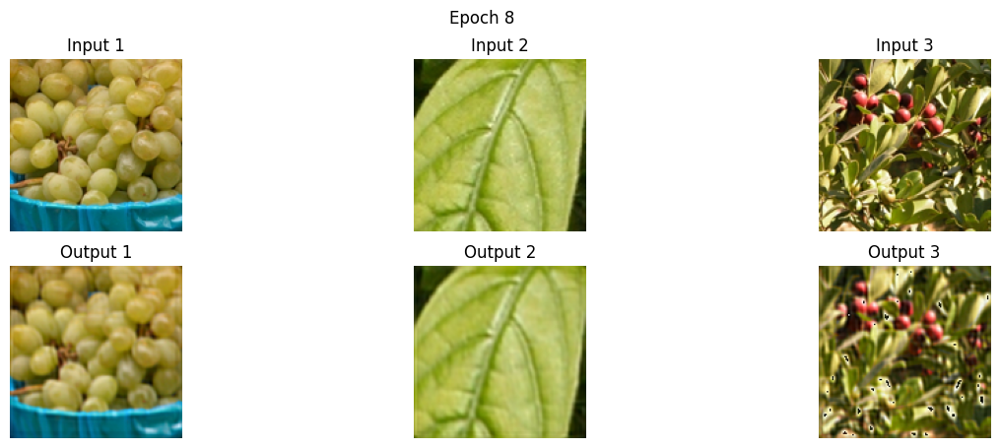

Epoch 10/50, Loss: 0.0017
Validation Loss: 0.0024, PSNR: 4.09


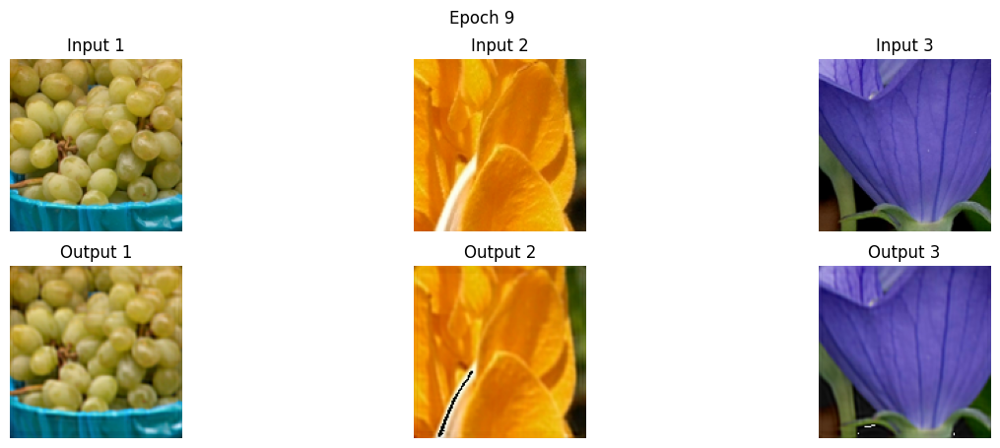

Epoch 11/50, Loss: 0.0014
Validation Loss: 0.0021, PSNR: 4.17


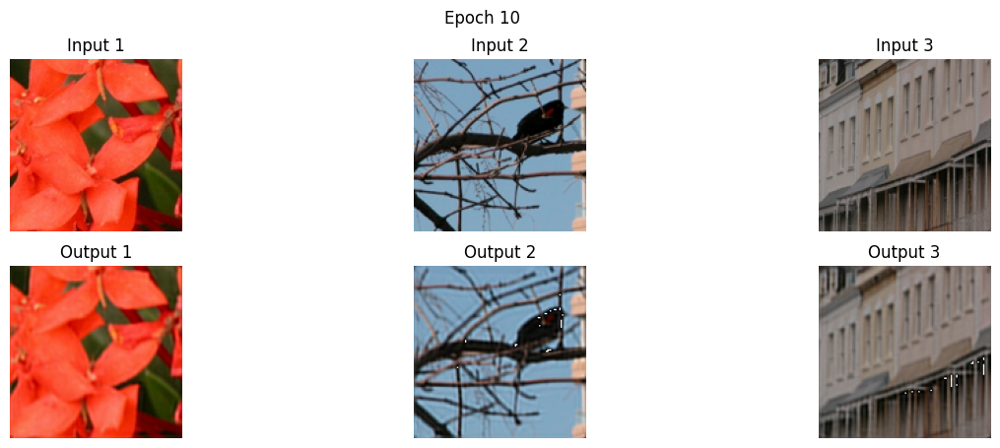

Epoch 12/50, Loss: 0.0014
Validation Loss: 0.0021, PSNR: 4.17


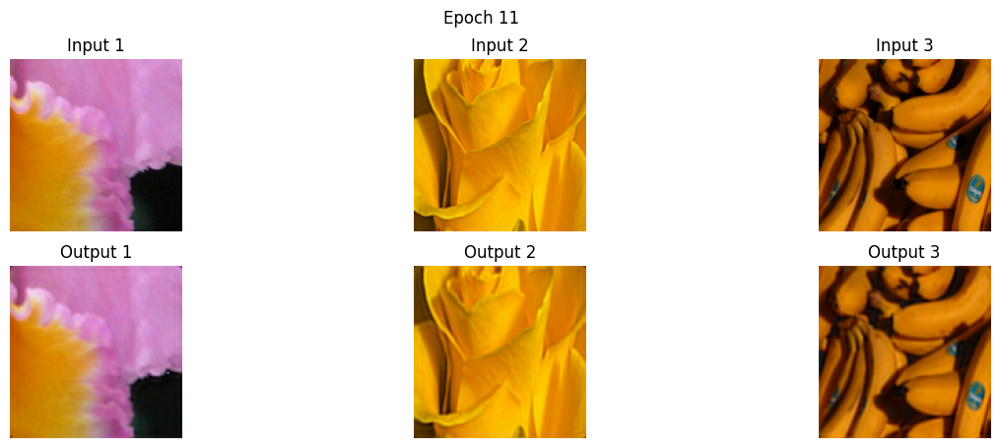

Epoch 13/50, Loss: 0.0012
Validation Loss: 0.0017, PSNR: 4.33


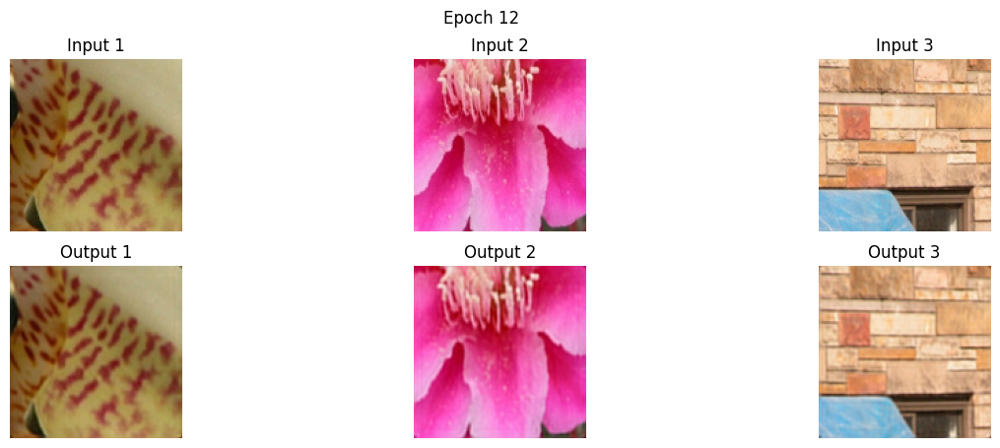

Epoch 14/50, Loss: 0.0010
Validation Loss: 0.0015, PSNR: 4.40


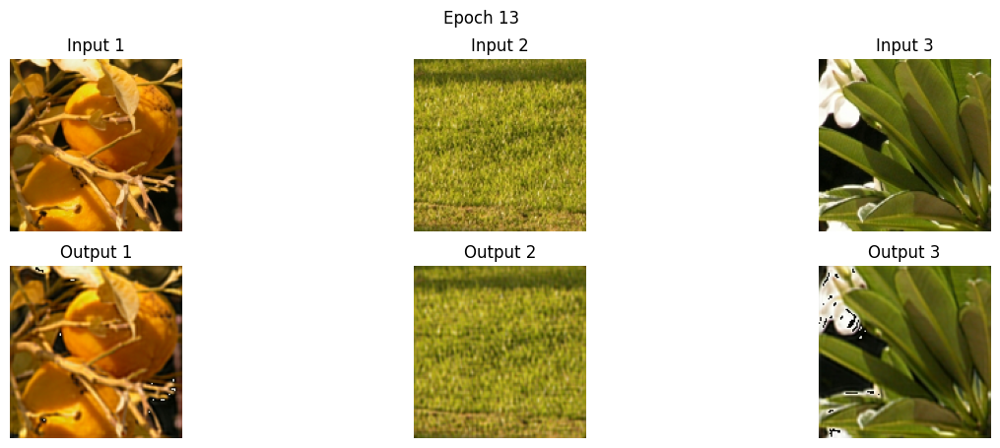

Epoch 15/50, Loss: 0.0009
Validation Loss: 0.0013, PSNR: 4.49


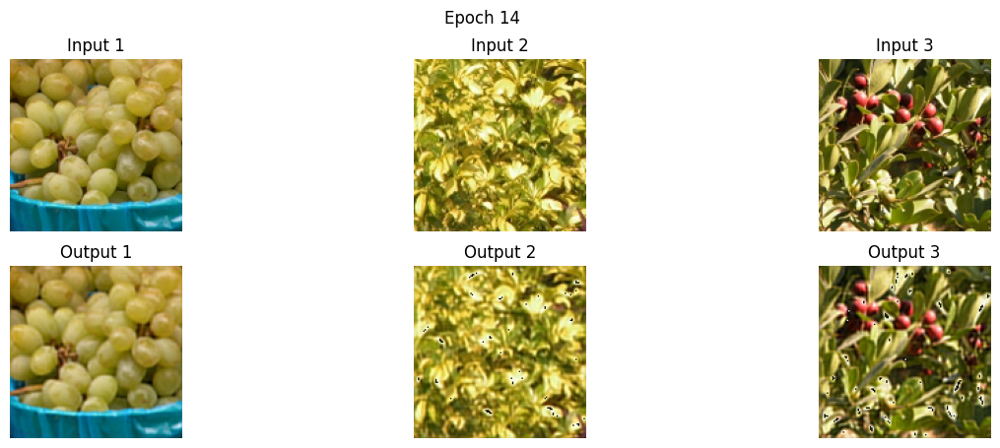

Epoch 16/50, Loss: 0.0018
Validation Loss: 0.0026, PSNR: 4.04


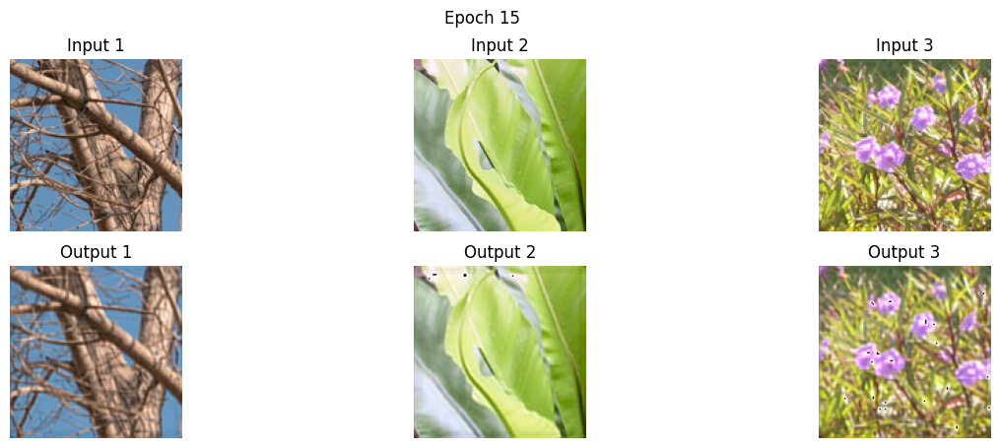

Epoch 17/50, Loss: 0.0014
Validation Loss: 0.0019, PSNR: 4.24


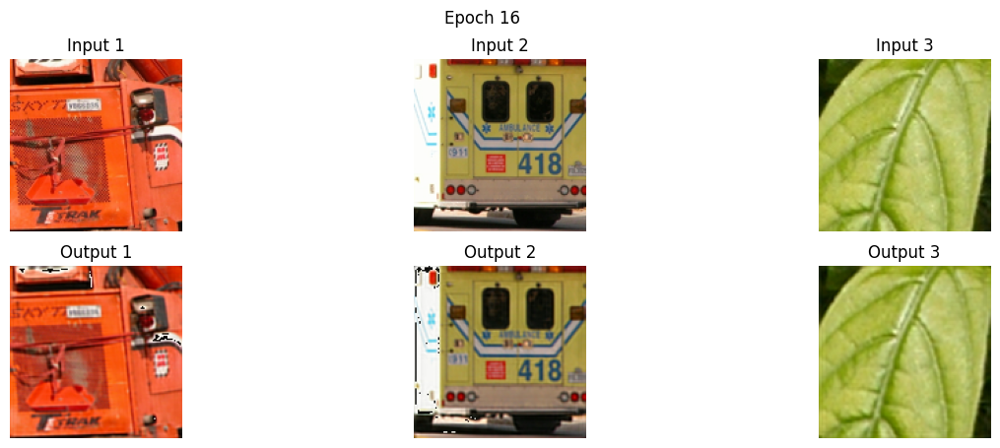

Epoch 18/50, Loss: 0.0010
Validation Loss: 0.0014, PSNR: 4.47


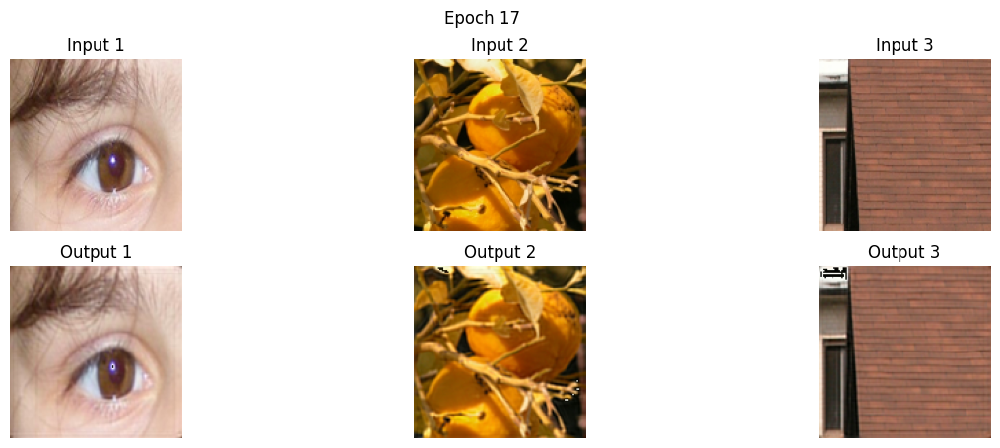

Epoch 19/50, Loss: 0.0008
Validation Loss: 0.0011, PSNR: 4.60


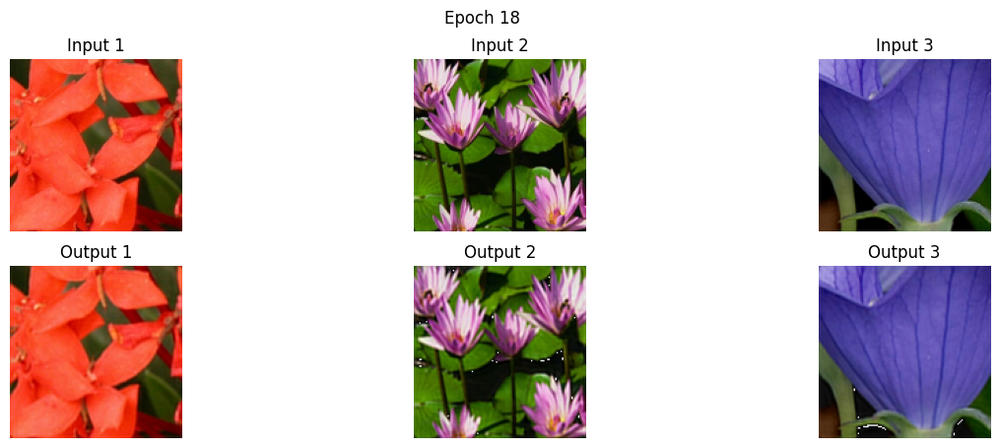

Epoch 20/50, Loss: 0.0007
Validation Loss: 0.0010, PSNR: 4.65


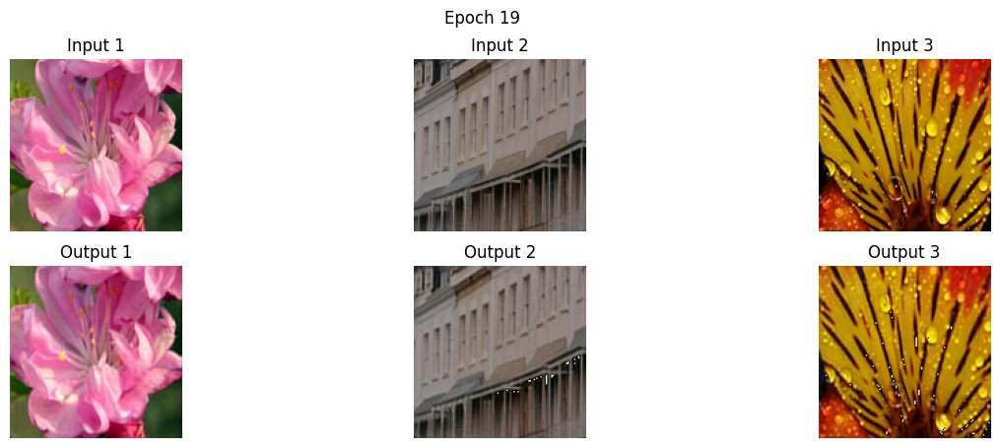

Epoch 21/50, Loss: 0.0006
Validation Loss: 0.0010, PSNR: 4.68


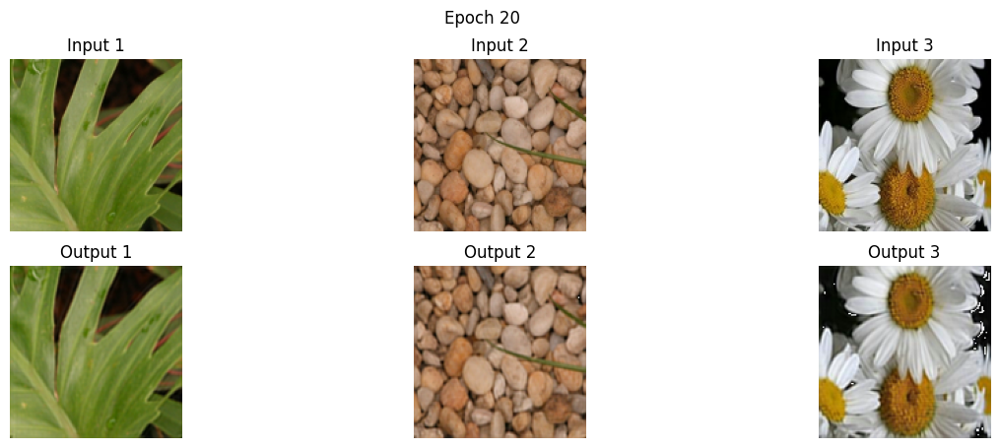

Epoch 22/50, Loss: 0.0007
Validation Loss: 0.0011, PSNR: 4.65


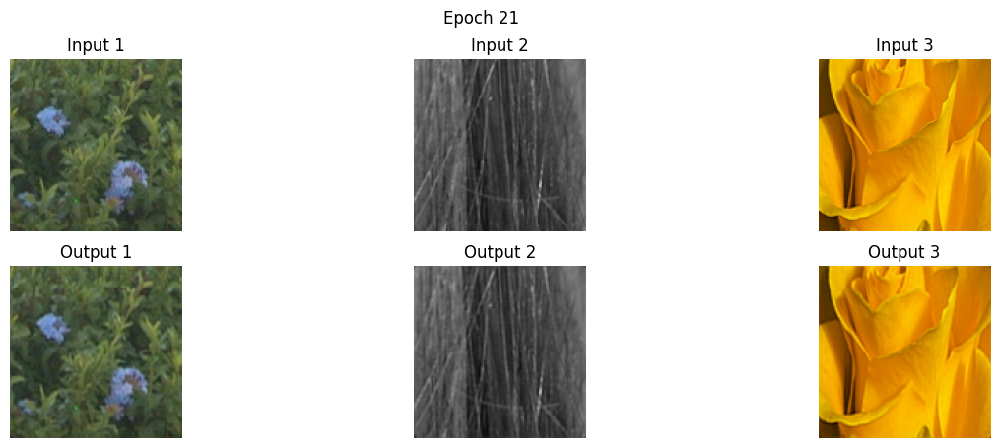

Epoch 23/50, Loss: 0.0006
Validation Loss: 0.0009, PSNR: 4.79


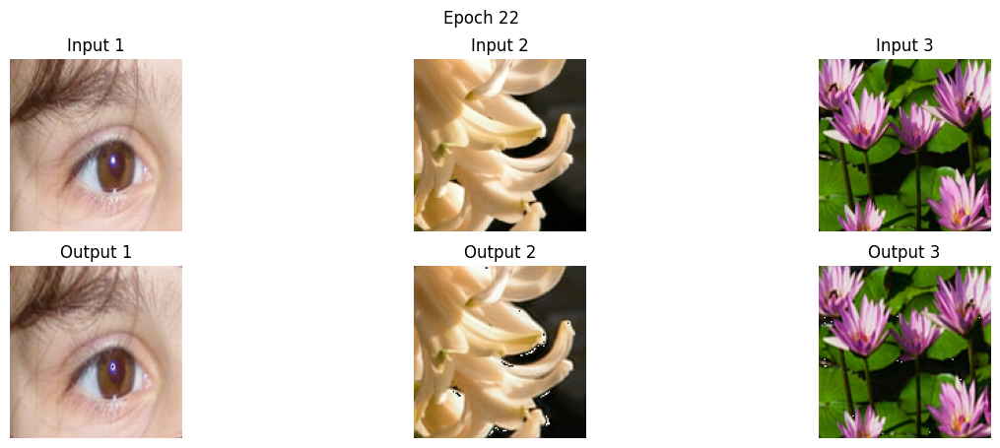

Epoch 24/50, Loss: 0.0005
Validation Loss: 0.0008, PSNR: 4.83


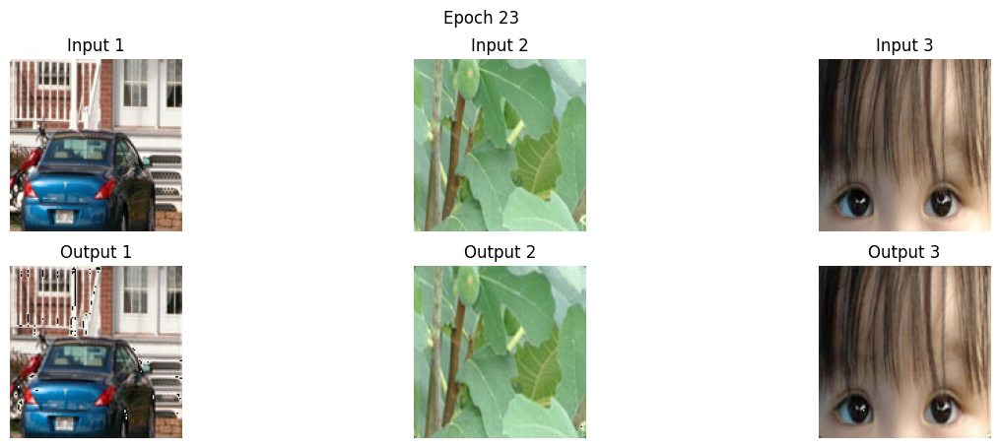

Epoch 25/50, Loss: 0.0005
Validation Loss: 0.0008, PSNR: 4.87


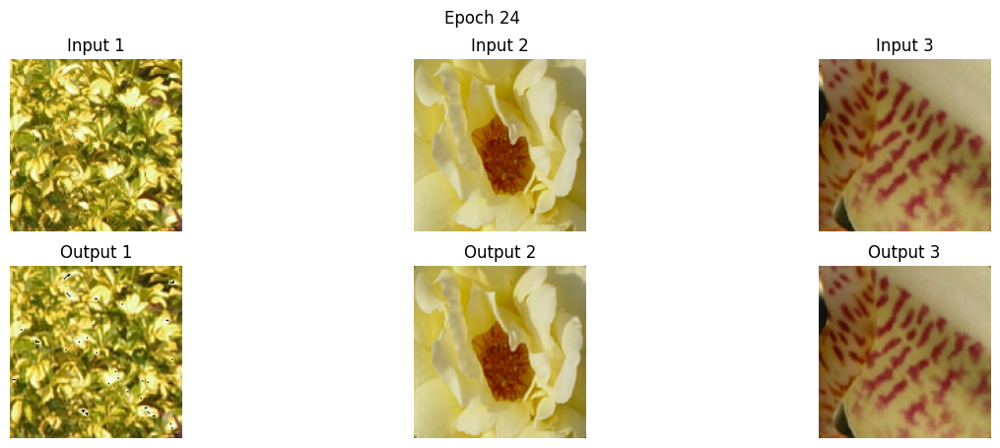

Epoch 26/50, Loss: 0.0005
Validation Loss: 0.0007, PSNR: 4.91


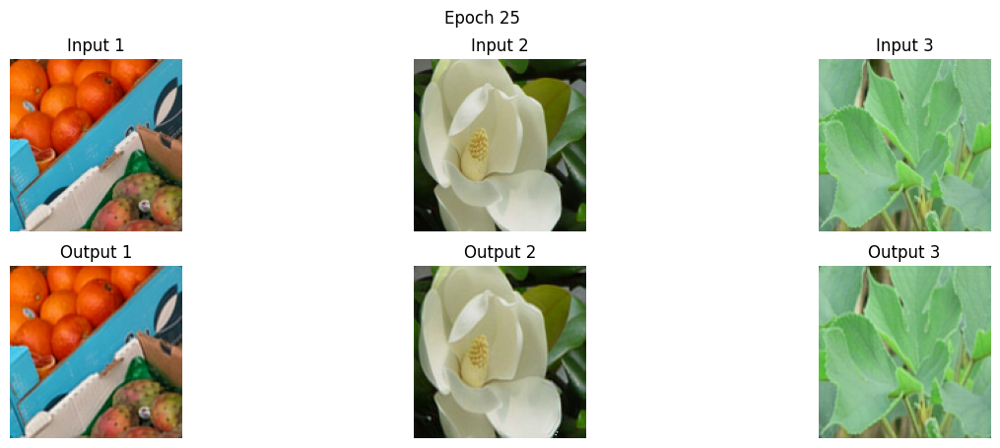

Epoch 27/50, Loss: 0.0004
Validation Loss: 0.0007, PSNR: 4.95


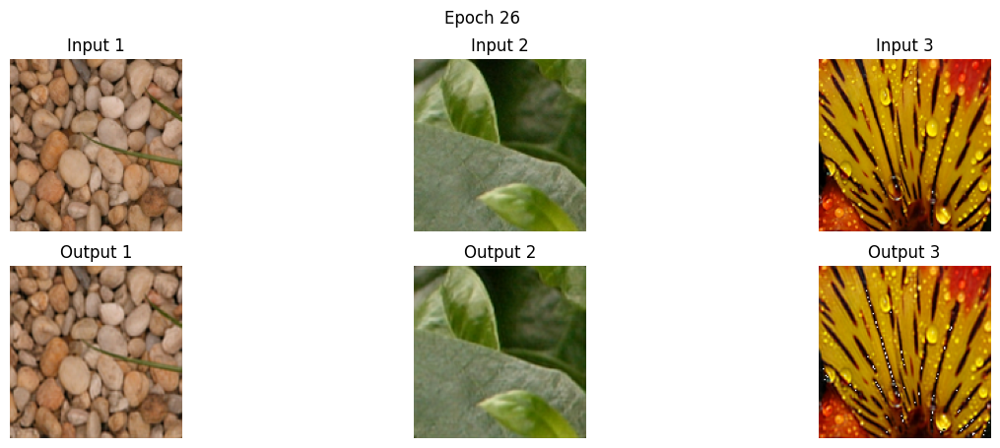

Epoch 28/50, Loss: 0.0004
Validation Loss: 0.0006, PSNR: 5.00


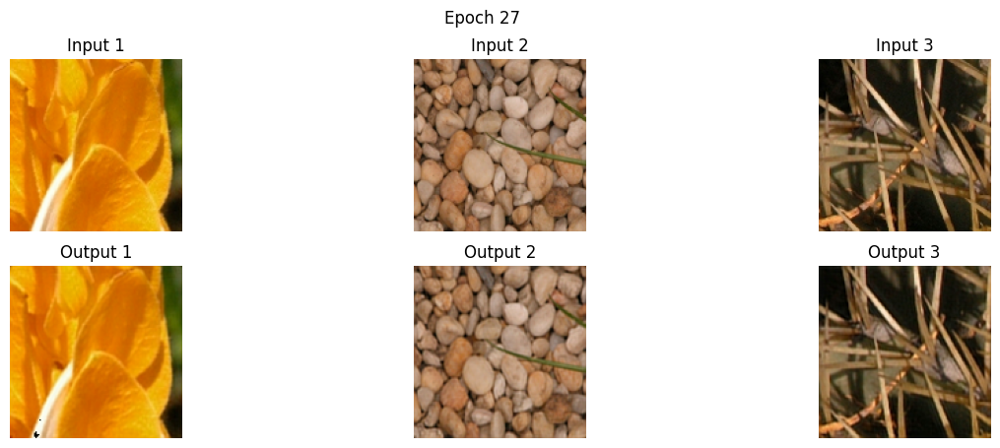

Epoch 29/50, Loss: 0.0004
Validation Loss: 0.0006, PSNR: 5.03


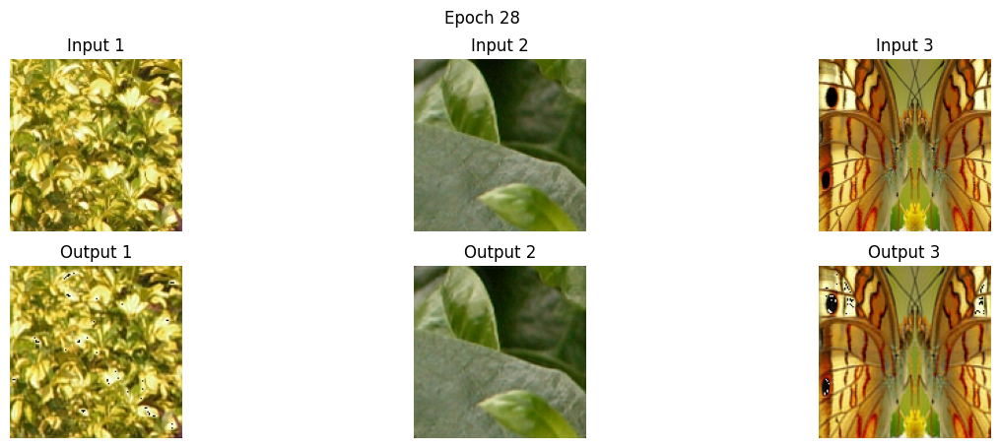

Epoch 30/50, Loss: 0.0004
Validation Loss: 0.0006, PSNR: 5.04


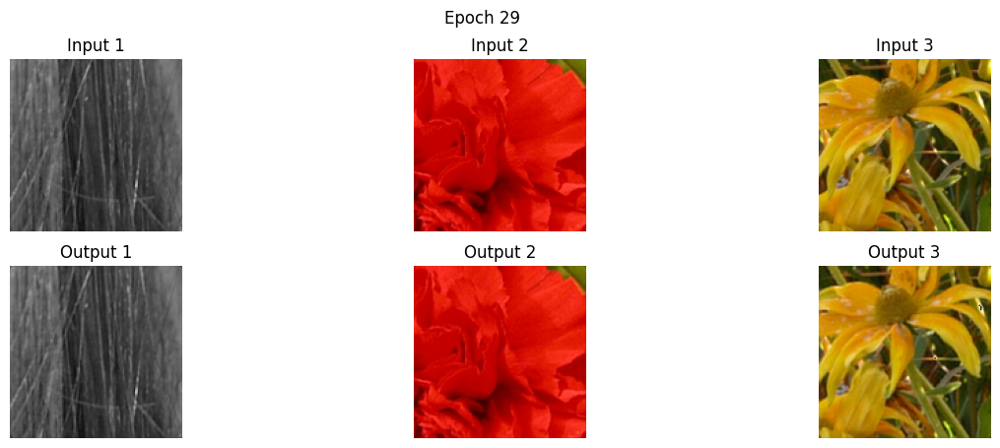

Epoch 31/50, Loss: 0.0005
Validation Loss: 0.0006, PSNR: 5.08


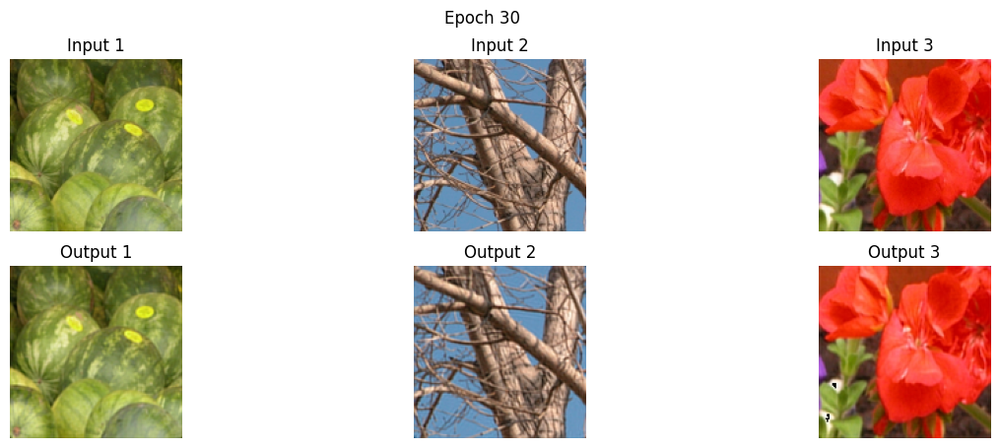

Epoch 32/50, Loss: 0.0004
Validation Loss: 0.0006, PSNR: 5.03


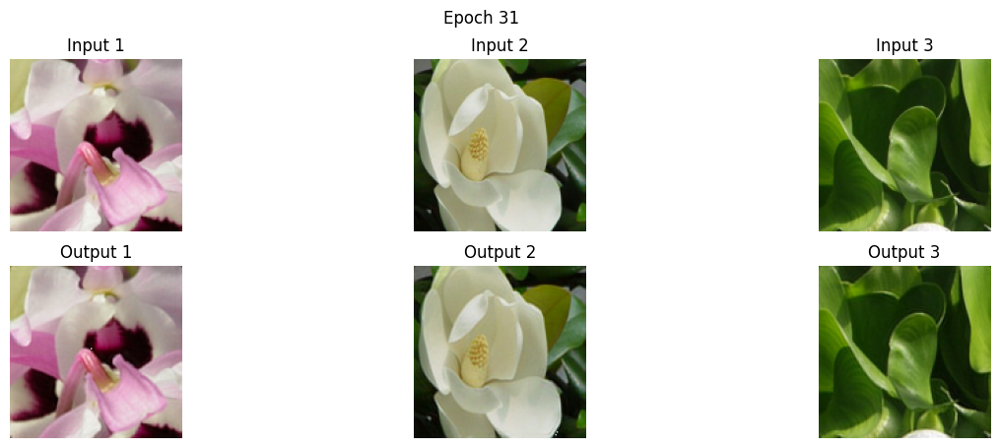

Epoch 33/50, Loss: 0.0003
Validation Loss: 0.0005, PSNR: 5.15


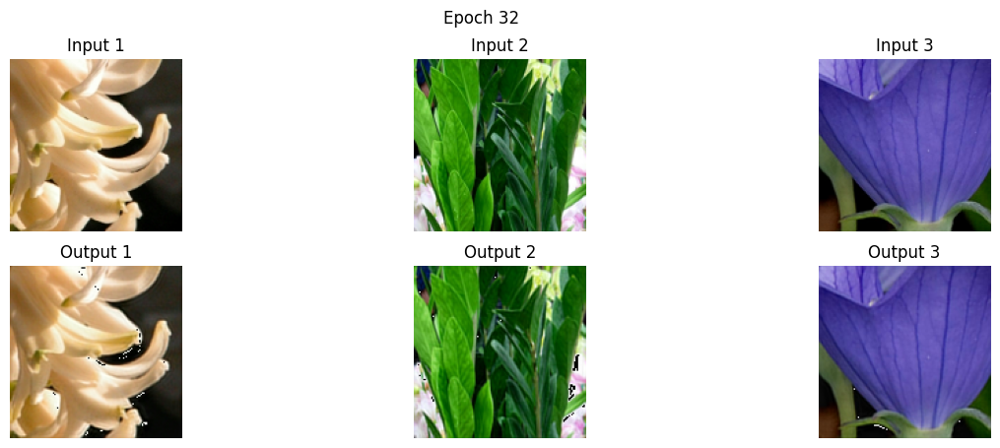

Epoch 34/50, Loss: 0.0003
Validation Loss: 0.0005, PSNR: 5.19


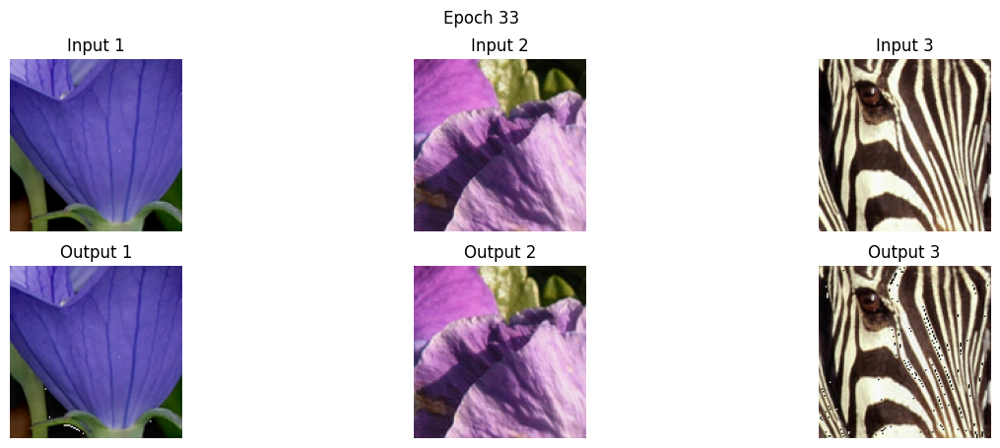

Epoch 35/50, Loss: 0.0003
Validation Loss: 0.0005, PSNR: 5.23


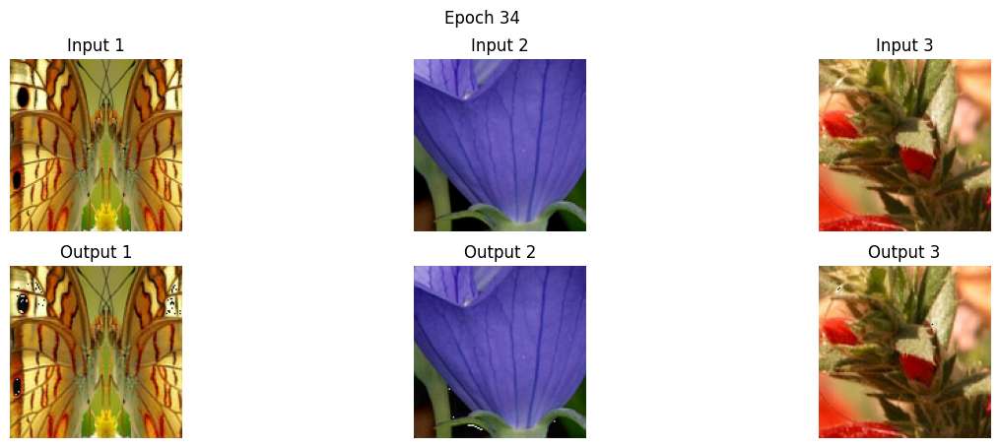

Epoch 36/50, Loss: 0.0003
Validation Loss: 0.0005, PSNR: 5.17


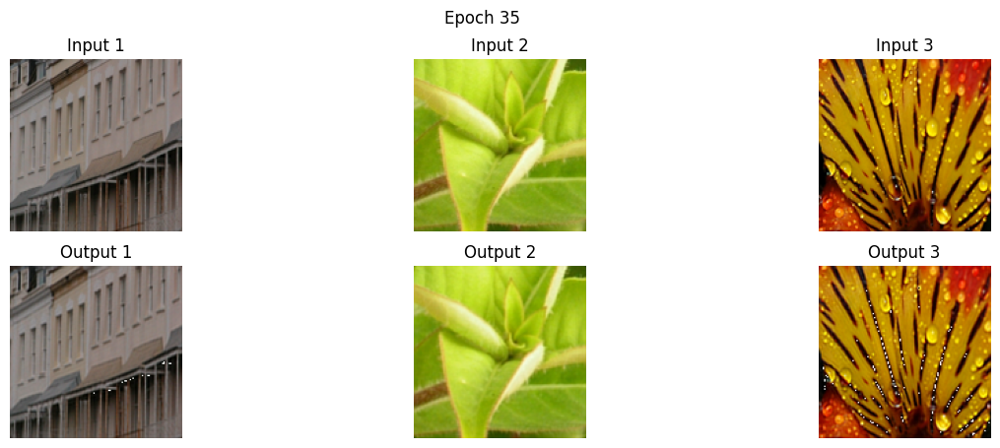

Epoch 37/50, Loss: 0.0003
Validation Loss: 0.0004, PSNR: 5.28


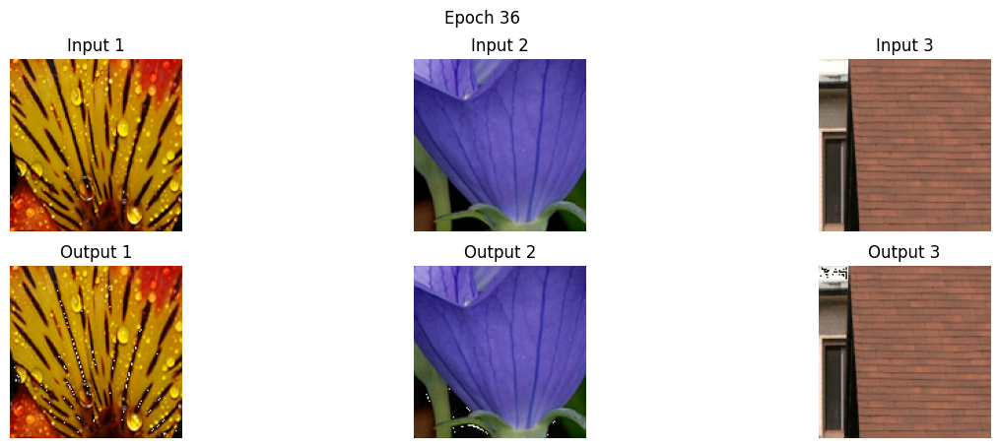

Epoch 38/50, Loss: 0.0003
Validation Loss: 0.0004, PSNR: 5.33


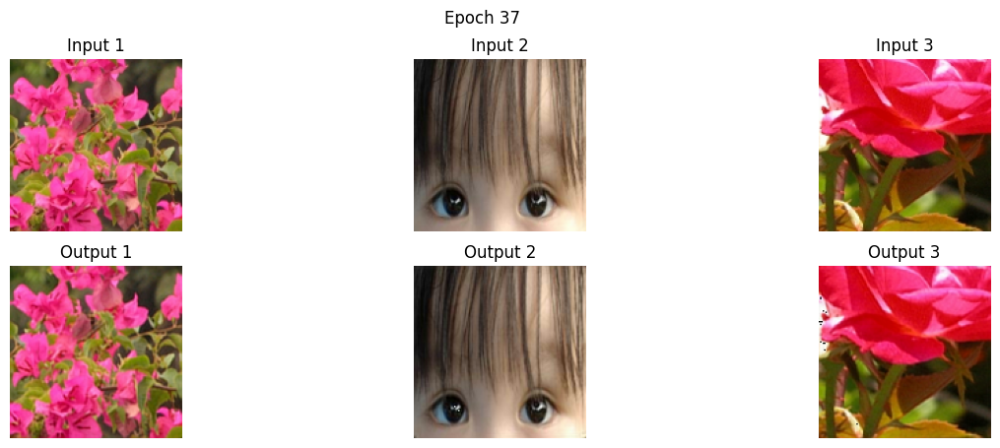

Epoch 39/50, Loss: 0.0003
Validation Loss: 0.0010, PSNR: 4.66


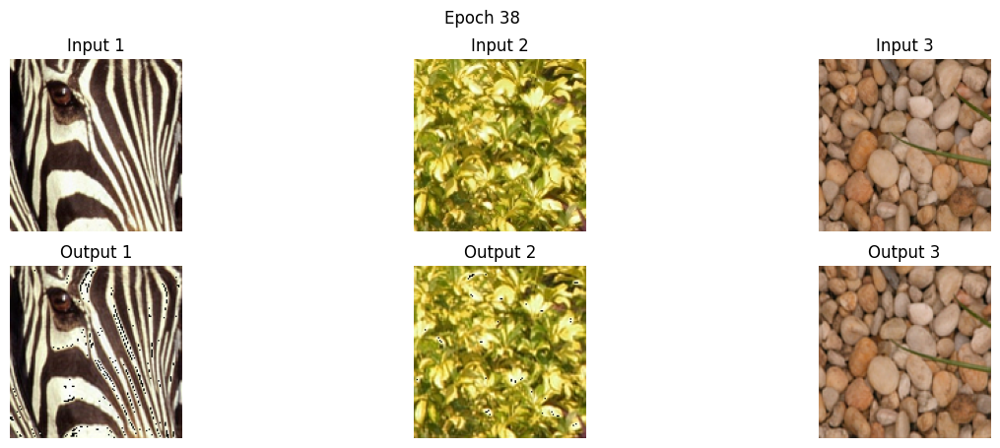

Epoch 40/50, Loss: 0.0004
Validation Loss: 0.0005, PSNR: 5.15


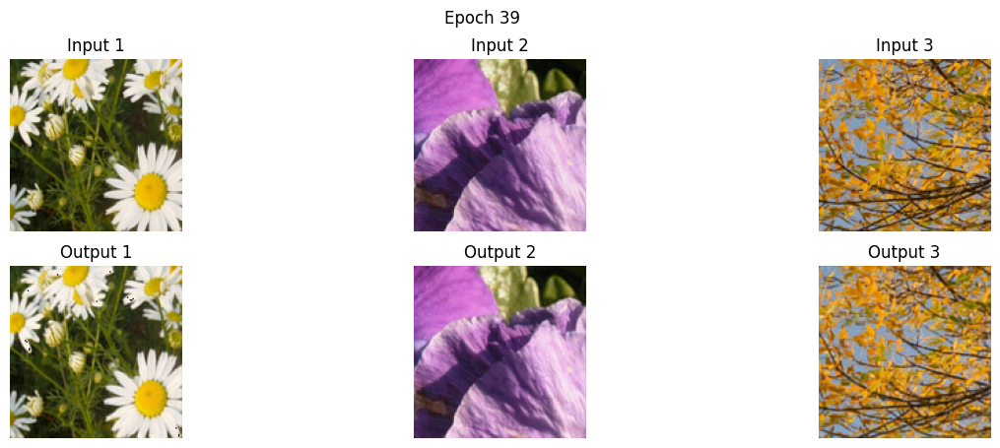

Epoch 41/50, Loss: 0.0004
Validation Loss: 0.0005, PSNR: 5.14


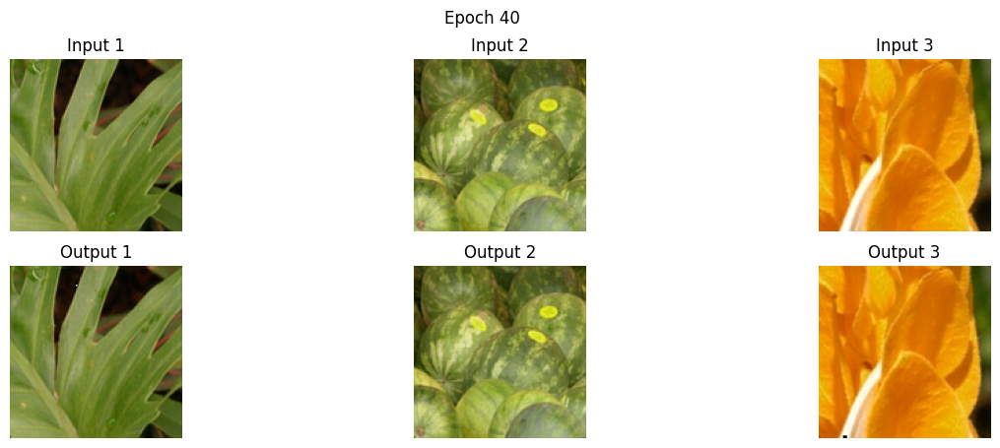

Epoch 42/50, Loss: 0.0003
Validation Loss: 0.0004, PSNR: 5.25


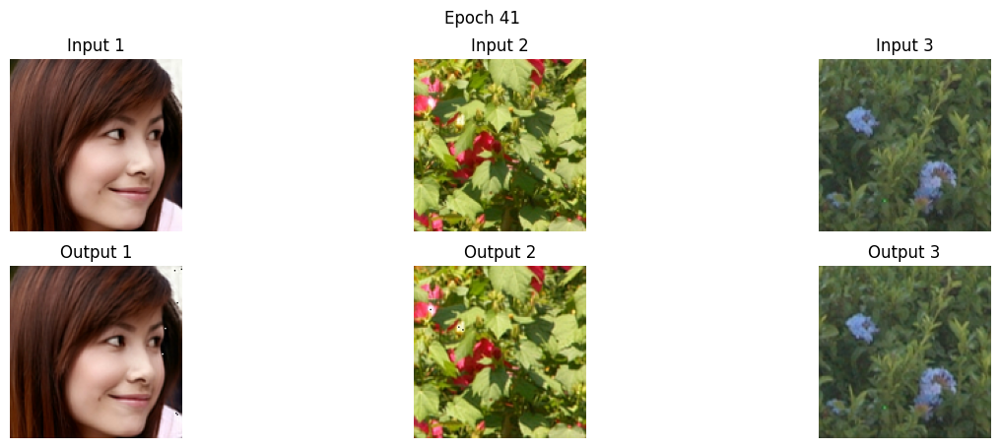

Epoch 43/50, Loss: 0.0002
Validation Loss: 0.0004, PSNR: 5.40


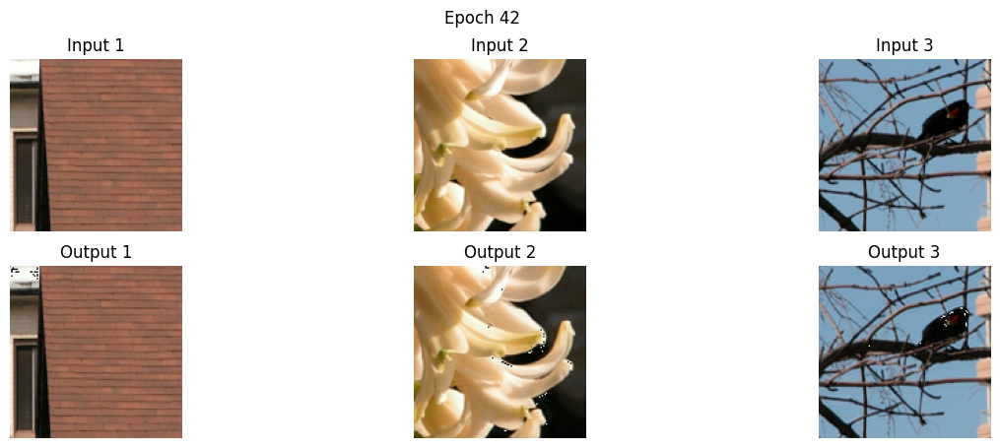

Epoch 44/50, Loss: 0.0002
Validation Loss: 0.0003, PSNR: 5.46


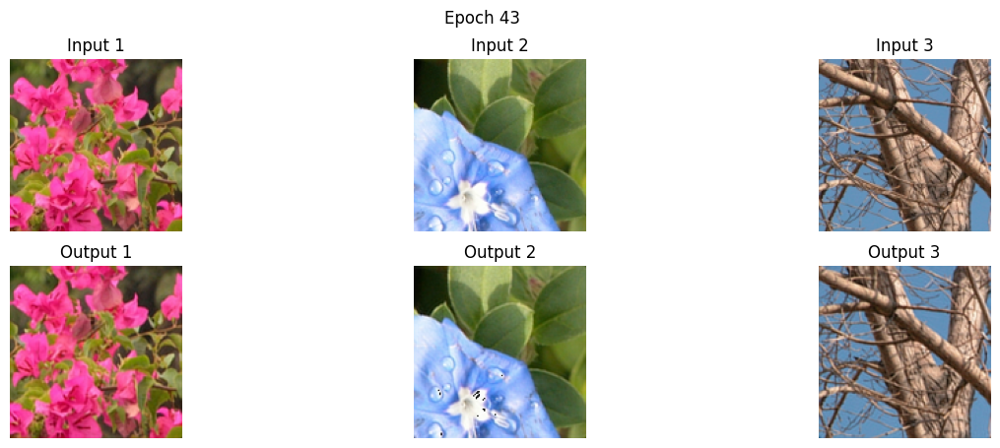

Epoch 45/50, Loss: 0.0002
Validation Loss: 0.0003, PSNR: 5.49


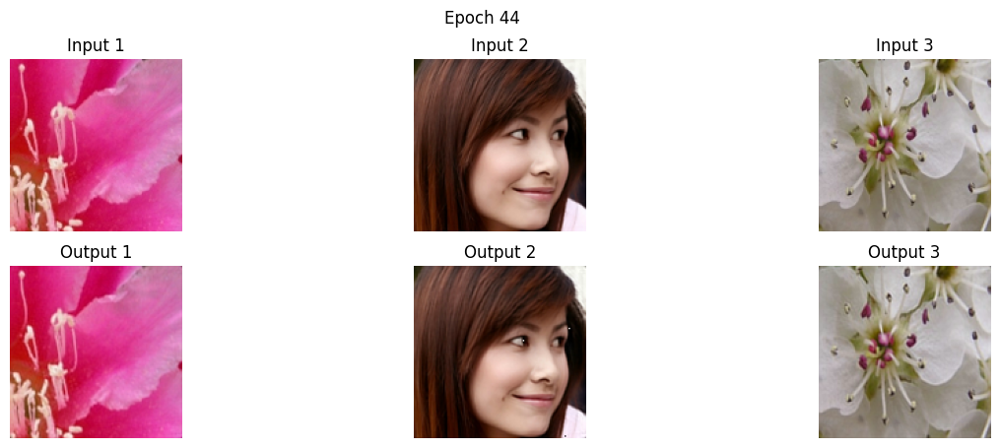

Epoch 46/50, Loss: 0.0002
Validation Loss: 0.0004, PSNR: 5.32


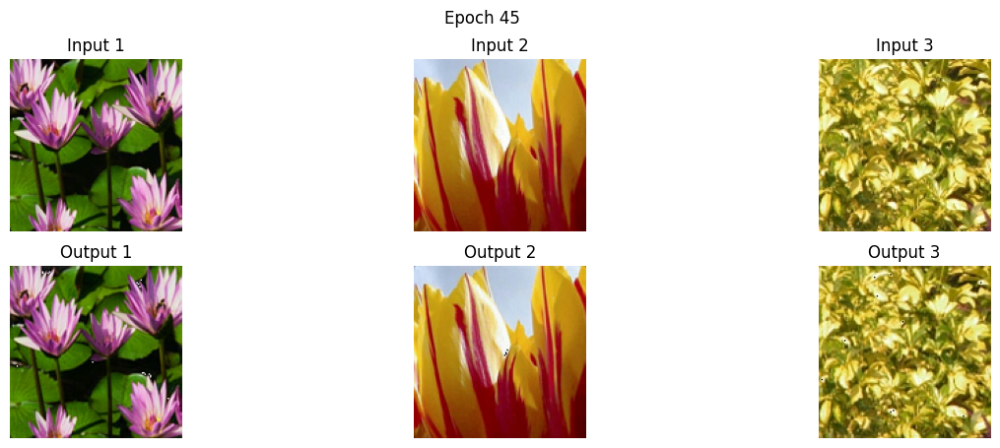

Epoch 47/50, Loss: 0.0002
Validation Loss: 0.0003, PSNR: 5.43


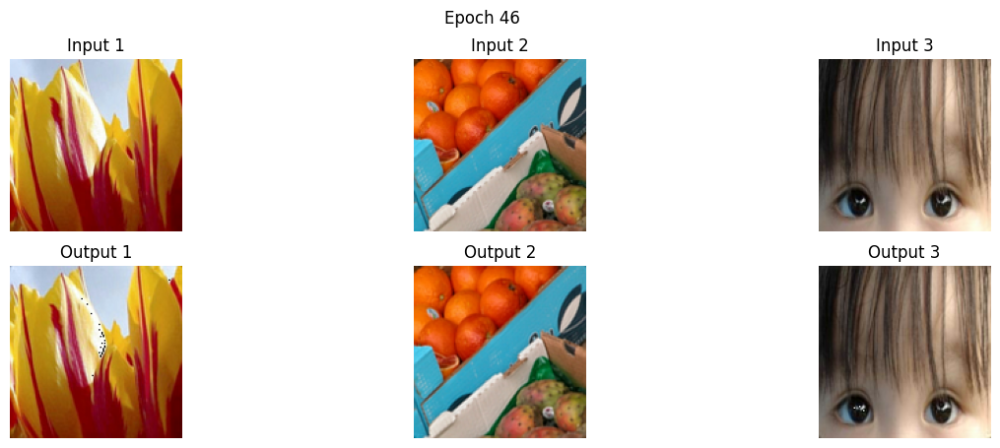

Epoch 48/50, Loss: 0.0002
Validation Loss: 0.0003, PSNR: 5.55


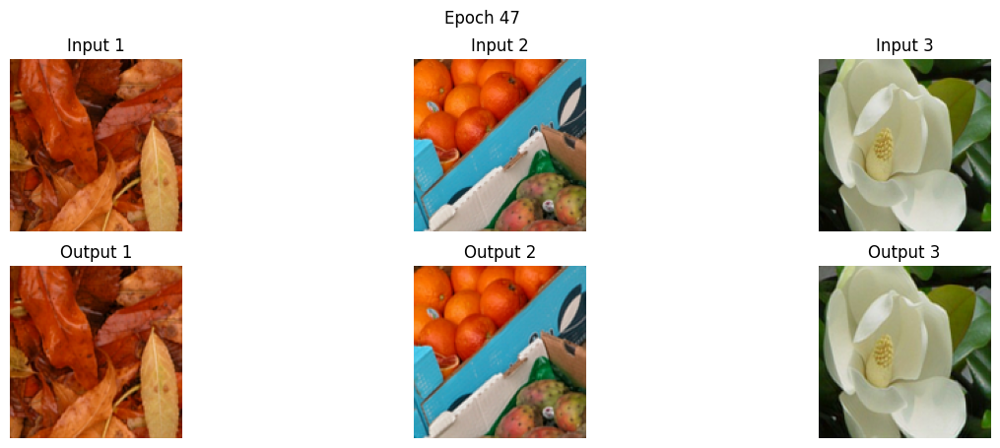

Epoch 49/50, Loss: 0.0002
Validation Loss: 0.0004, PSNR: 5.40


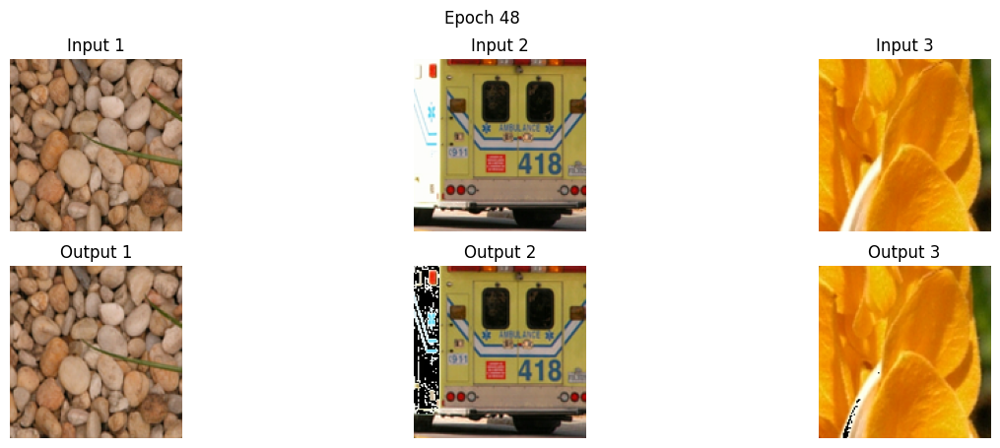

Epoch 50/50, Loss: 0.0002
Validation Loss: 0.0003, PSNR: 5.55


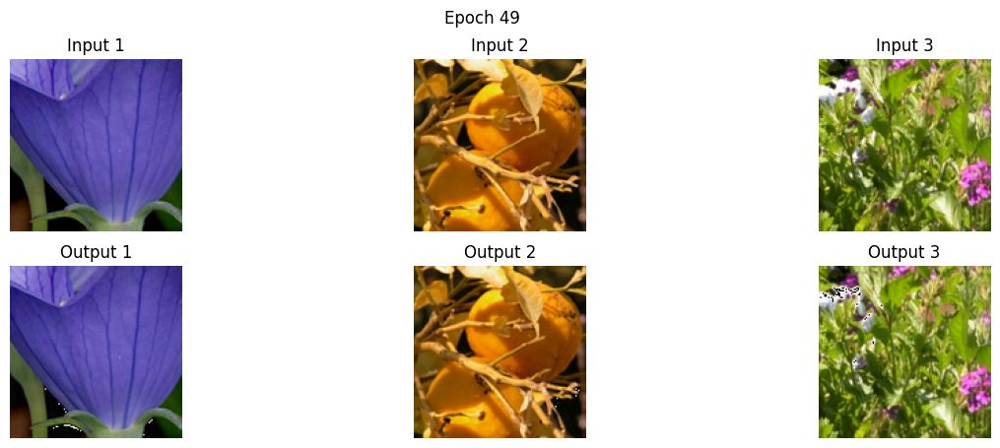

Training complete


TypeError: can't convert cuda:0 device type tensor to numpy. Use Tensor.cpu() to copy the tensor to host memory first.

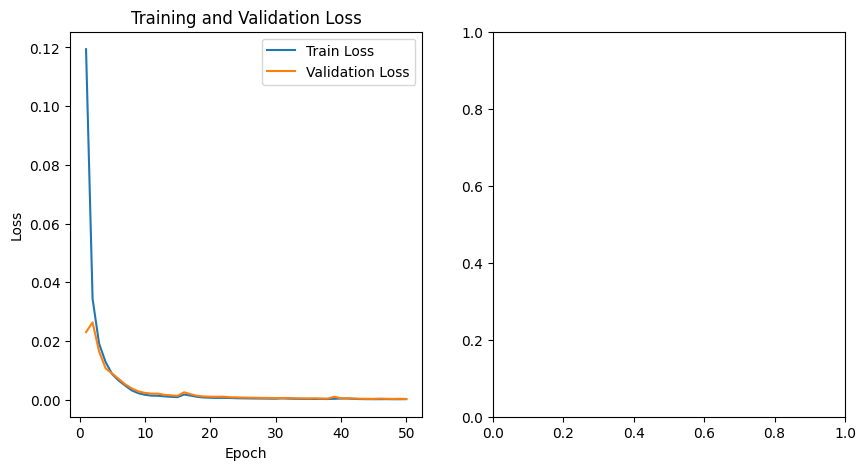

In [10]:
# Training and evaluation
train_losses = []
val_losses = []
psnrs = []

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for inputs, targets, cb, cr in train_loader:
        inputs, targets = inputs.to(device), targets.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * inputs.size(0)
    
    epoch_loss = running_loss / len(train_loader.dataset)
    train_losses.append(epoch_loss)
    print(f'Epoch {epoch+1}/{num_epochs}, Loss: {epoch_loss:.4f}')
    
    val_loss, psnr = evaluate(model, val_loader, criterion, device)
    if val_loss is not None:
        val_losses.append(val_loss)
        psnrs.append(psnr)
        print(f'Validation Loss: {val_loss:.4f}, PSNR: {psnr:.2f}')
    else:
        print('Skipping validation loss computation due to empty validation dataset.')
    
    # Visualize some sample outputs
    visualize_images(inputs, outputs, cb, cr, epoch)
    
    # Save the model
    torch.save(model.state_dict(), f'checkpoints/srcnn_epoch_{epoch+1}.pth')

print('Training complete')

# Plot losses and PSNR
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(range(1, num_epochs+1), train_losses, label='Train Loss')
plt.plot(range(1, num_epochs+1), val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

plt.subplot(1, 2, 2)
plt.plot(range(1, num_epochs+1), psnrs, label='PSNR')
plt.xlabel('Epoch')
plt.ylabel('PSNR')
plt.legend()
plt.title('PSNR over Epochs')

plt.savefig('training_plots.png')
plt.show()